In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
import deeplake
from torchvision import transforms, models, datasets
import flask
from deeplake.core.vectorstore.deeplake_vectorstore import VectorStore
import os
import torch
from torchvision.models.feature_extraction import create_feature_extractor
from PIL import Image

/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/util/check_latest_version.py:32: UserWarning: A newer version of deeplake (3.8.28) is available. It's recommended that you update to the latest version using `pip install -U deeplake`.
  warnings.warn(
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c1017RegisterOperatorsD1Ev
  Referenced from: <2BDBC688-E93D-38EE-BBB2-E3BEEEAB3977> /Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/image.so
  Expected in:     <F37A8933-BE2B-34BD-AE9A-CEE18F73F614> /Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torch/lib/libtorch_cpu.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. 

## Load Data

In [12]:
# Load WikiArt
ds = deeplake.load('hub://activeloop/wiki-art')


# Create transform
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataloader = ds.pytorch(transform=transform, batch_size=32, shuffle=False, tensors=['images', 'labels'])

Opening dataset in read-only mode as you don't have write permissions.


/

This dataset can be visualized in Jupyter Notebook by ds.visualize() or at https://app.activeloop.ai/activeloop/wiki-art



/

hub://activeloop/wiki-art loaded successfully.



/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/integrations/pytorch/common.py:137: UserWarning: Decode method for tensors ['images'] is defaulting to numpy. Please consider specifying a decode_method in .pytorch() that maximizes the data preprocessing speed based on your transformation.
  warnings.warn(


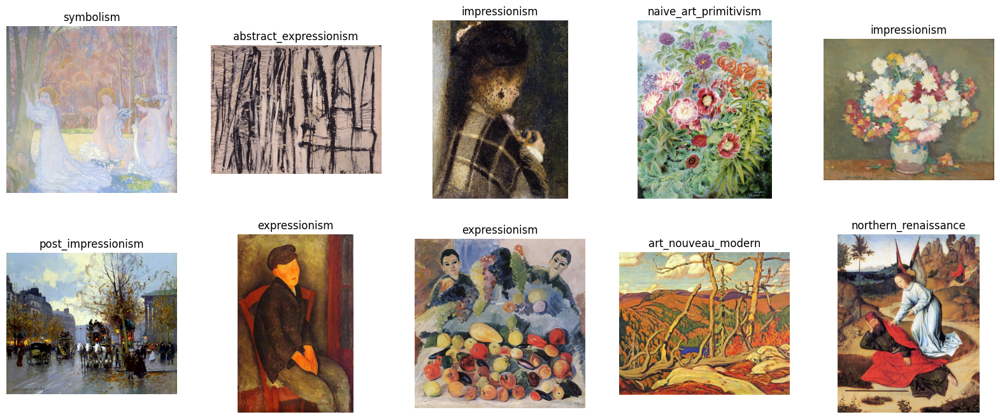

In [13]:
# Show the first 10 images

# Create a grid of images
fig, ax = plt.subplots(2, 5, figsize=(20, 8))

# Get 10 random indices
indices = range(0, len(ds))
indices = np.random.choice(indices, 10, replace=False)
indices = [int(i) for i in indices]

first_images = []

# Plot the images
for i, index in enumerate(indices):
    img = ds.images[index].numpy()
    first_images.append(img)
    label = ds.labels[index].data()
    title = label['text'][0]
    ax[i // 5, i % 5].imshow(img)
    ax[i // 5, i % 5].set_title(title)
    ax[i // 5, i % 5].axis('off')

**We need to confirm that with the same indices that the images are the same on independent loads of the dataset**

## Reload the Data

In [14]:
# Load WikiArt
ds = deeplake.load('hub://activeloop/wiki-art')


# Create transform
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataloader = ds.pytorch(transform=transform, batch_size=32, shuffle=False, tensors=['images', 'labels'])

Opening dataset in read-only mode as you don't have write permissions.
This dataset can be visualized in Jupyter Notebook by ds.visualize() or at https://app.activeloop.ai/activeloop/wiki-art



\

hub://activeloop/wiki-art loaded successfully.



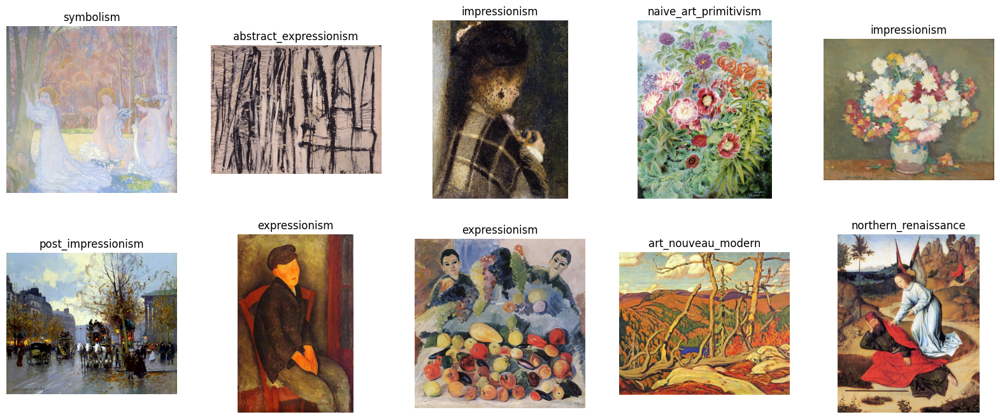

In [15]:
# Create a grid of images
fig2, ax = plt.subplots(2, 5, figsize=(20, 8))

### USE THE SAME INDICES AS ABOVE ###

second_images = []

# Plot the images
for i, index in enumerate(indices):
    img = ds.images[index].numpy()
    second_images.append(img)
    label = ds.labels[index].data()
    title = label['text'][0]
    ax[i // 5, i % 5].imshow(img)
    ax[i // 5, i % 5].set_title(title)
    ax[i // 5, i % 5].axis('off')

In [22]:
# Check that the images are the same
assert [np.allclose(first_images[i], second_images[i]) for i in range(10)].count(True) == 10

Therefore we can use the same indices to load the data and confirm that the images are the same.

## Get art styles

In [32]:
# Print the unique labels
unique_labels = ds.labels.data()['text']
unique_labels = [label[0] for label in unique_labels]
unique_labels = set(unique_labels)
print(f'Number of unique labels: {len(unique_labels)}')
print('Unique labels:')
for label in unique_labels:
    print(label)

Number of unique labels: 27
Unique labels:
northern_renaissance
color_field_painting
naive_art_primitivism
action_painting
expressionism
high_renaissance
impressionism
post_impressionism
realism
rococo
new_realism
synthetic_cubism
baroque
abstract_expressionism
contemporary_realism
art_nouveau_modern
analytical_cubism
romanticism
pop_art
minimalism
early_renaissance
fauvism
mannerism_late_renaissance
cubism
pointillism
ukiyo_e
symbolism


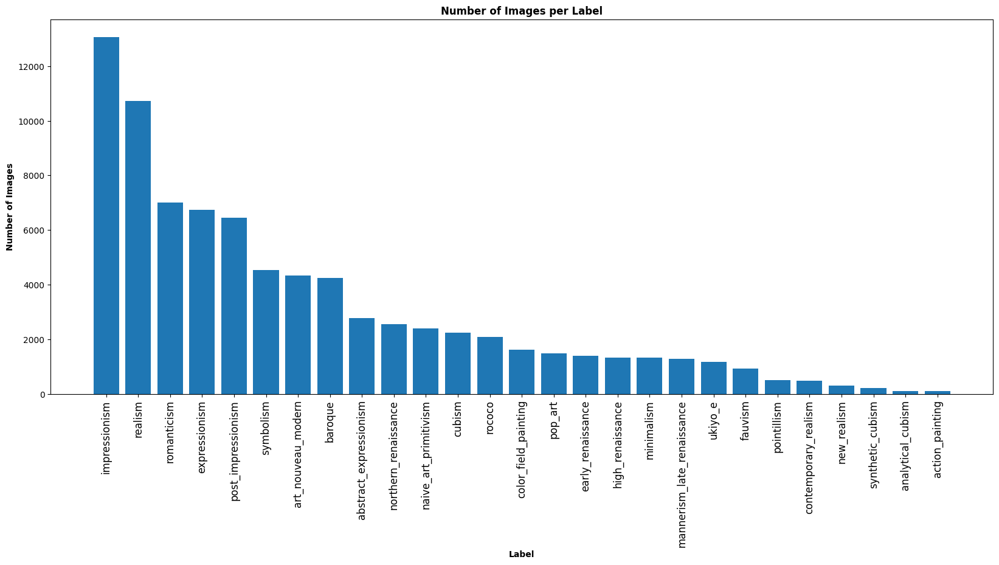

In [37]:
# Create a dictionary with the labels as keys and the indices as values
label_dict = {}
for i, label in enumerate(ds.labels.data()['text']):
    label = label[0]
    if label in label_dict:
        label_dict[label].append(i)
    else:
        label_dict[label] = [i]

# Create a dictionary with the labels as keys and the number of images as values
label_count = {}
for label, indices in label_dict.items():
    label_count[label] = len(indices)

# Sort the dictionary by the number of images
label_count = dict(sorted(label_count.items(), key=lambda item: item[1], reverse=True))

# Plot the number of images per label
plt.figure(figsize=(20, 8))
plt.bar(label_count.keys(), label_count.values())
plt.xticks(rotation=90, fontsize=12)
plt.xlabel('Label', fontdict={'fontweight': 'bold'})
plt.ylabel('Number of Images', fontdict={'fontweight': 'bold'})
plt.title('Number of Images per Label', fontdict={'fontweight': 'bold'})
plt.show()

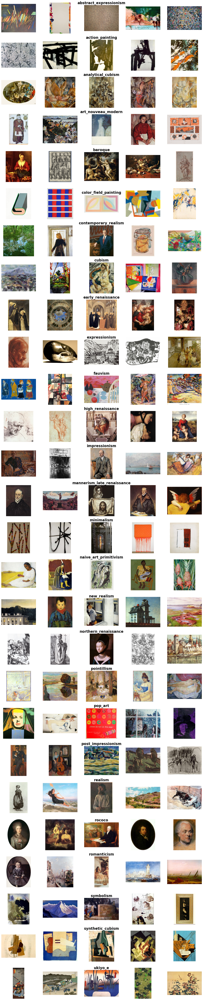

In [50]:
import matplotlib.pyplot as plt
import numpy as np

fig, ax = plt.subplots(27, 5, figsize=(20, 100))

row = 0

# For each label, plot the first 5 images
for label, indices in label_dict.items():
    
    # Select 5 random indices
    indices = np.random.choice(indices, 5, replace=False)

    # Plot the images
    for i, index in enumerate(indices):
        index = int(index)
        img = ds.images[index].numpy()
        ax[row, i].imshow(img)
        ax[row, i].axis('off')

        # Set the title on the third image
        if i == 2:
            ax[row, i].set_title(label, fontsize=20, fontweight='bold')

    row += 1

plt.show()


Styles to keep:
- art_nouveau_modern
- baroque
- contemporary_realism
- cubism
- early_renaissance
- expressionism
- fauvism
- high_renaissance
- impressionism
- mannerism_late_renaissance
- minimalism
- naive_art_primitivism
- new_realism
- northern_renaissance
- pointillism
- pop_art
- post_impressionism
- realism
- rococo
- romanticism
- ukiyo_e

In [52]:
styles_to_keep = [
    "art_nouveau_modern",
    "baroque",
    "contemporary_realism",
    "cubism",
    "early_renaissance",
    "expressionism",
    "fauvism",
    "high_renaissance",
    "impressionism",
    "mannerism_late_renaissance",
    "minimalism",
    "naive_art_primitivism",
    "new_realism",
    "northern_renaissance",
    "pointillism",
    "pop_art",
    "post_impressionism",
    "realism",
    "rococo",
    "romanticism",
    "symbolism",
    "ukiyo_e"
]

# Show how many images are kept
total_images = 0
for style in styles_to_keep:
    total_images += label_count[style]

print(f'Total number of images: {sum(label_count.values())}')
print(f'Number of images kept: {total_images}')
print(f'Number of images removed: {sum(label_count.values()) - total_images}')
print(f'Percentage of images kept: {total_images / sum(label_count.values()) * 100:.2f}%')

Total number of images: 81433
Number of images kept: 76612
Number of images removed: 4821
Percentage of images kept: 94.08%


# Collect Final Images

Naming convention: 

`style_{style_name}_index_{index}.jpg`

Or if there is a crop:

`style_{style_name}_index_{index}_bounding_box_{x1}_{y1}_{x2}_{y2}.jpg`

In [ ]:
# Check if data/images folder exists
if not os.path.exists('../data/raw'):
    os.makedirs('../data/raw')
    print('Created ../data/raw folder')
else:
    print('../data/raw folder already exists')


raw_image_path = '../data/raw'

# Function to save images by index 
def save_image(index, folder):
    index = int(index)
    img = ds.images[index].numpy()
    img = Image.fromarray(img)

    label = ds.labels[index].data()
    style = label['text'][0]

    if style in styles_to_keep:
        path = os.path.join(folder, f'style_{style}_index_{index}.jpg')

        # Check if the image already exists
        if os.path.exists(path):
            print(f'Image {path} already exists')
            return
        
        else:
            img.save(path)

# Test with the 10 random indices
indices = range(0, len(ds))
indices = np.random.choice(indices, 10, replace=False)
for index in indices:
    save_image(index, raw_image_path)

In [70]:
# Get all the indices for the styles to keep
indices_to_keep = []
for style in styles_to_keep:
    indices = label_dict[style]
    indices_to_keep.extend(indices)

print(f'Number of indices to keep: {len(indices_to_keep)}')
print(f'First 10 indices to keep: {indices_to_keep[:10]}')

Number of indices to keep: 76612
First 10 indices to keep: [2990, 2991, 2992, 2993, 2994, 2995, 2996, 2997, 2998, 2999]


In [72]:
# Clean the raw folder
for file in os.listdir(raw_image_path):
    if file.endswith('.jpg'):
        os.remove(os.path.join(raw_image_path, file))

print(f'Number of images in {raw_image_path}: {len(os.listdir(raw_image_path))}')

Number of images in ../data/raw: 1


In [73]:
import multiprocessing as mp
from tqdm import tqdm
import time

# Set the number of processes
num_processes = mp.cpu_count() - 2
print(f'Number of processes: {num_processes}')

# Create a pool of processes
pool = mp.Pool(processes=num_processes)

# Save all images
for index in tqdm(indices_to_keep):
    pool.apply_async(save_image, args=(index, raw_image_path))

# Close the pool
pool.close()

# Wait for the processes to finish
pool.join()

# Pause for 5 seconds to let the processes finish
time.sleep(5)

# Print the number of images in the folder
print(f'Number of images in {raw_image_path}: {len(os.listdir(raw_image_path))}')

Number of processes: 6


100%|██████████| 76612/76612 [00:02<00:00, 30589.58it/s]
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/core/tensor.py:714: UserWarning: Indexing by integer in a for loop, like `for i in range(len(ds)): ... ds.tensor[i]` can be quite slow. Use `for i, sample in enumerate(ds)` instead.
  warnings.warn(
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/core/tensor.py:714: UserWarning: Indexing by integer in a for loop, like `for i in range(len(ds)): ... ds.tensor[i]` can be quite slow. Use `for i, sample in enumerate(ds)` instead.
  warnings.warn(
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/core/tensor.py:714: UserWarning: Indexing by integer in a for loop, like `for i in range(len(ds)): ... ds.tensor[i]` can be quite slow. Use `for i, sample in enumerate(ds)` instead.
  warnings.warn(
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/core/tensor.py:714: UserWa

Number of images in ../data/raw: 76611
